# Building Ligand Networks from Real World Data with **konnektor** and **kartograf**

Here we build a network based on a real world case using **konnektor** along with [kartograf](https://kartograf.openfree.energy), the OpenFE ecosystem's atom mapping tool.

We take the chemical molecules from our Kartograf publication and create mappings between them using Kartograf’s [AtomMapper](https://kartograf.openfree.energy/en/latest/guide/atom_mapping.html) and its RMSD-based [AtomMappingScorer](https://kartograf.openfree.energy/en/latest/api/kartograf.metrics.html#kartograf.mapping_metrics.metric_mapping_rmsd.MappingRMSDScorer)

Additionally we demonstrate the interactive widget that gives immediatley insights into the ``Components`` (nodes) and ``AtomMappings`` (edges) of a ``LigandNetwork``.

## Fetching the input data and building the `AtomMapper` and `AtomMappingScorer` classes

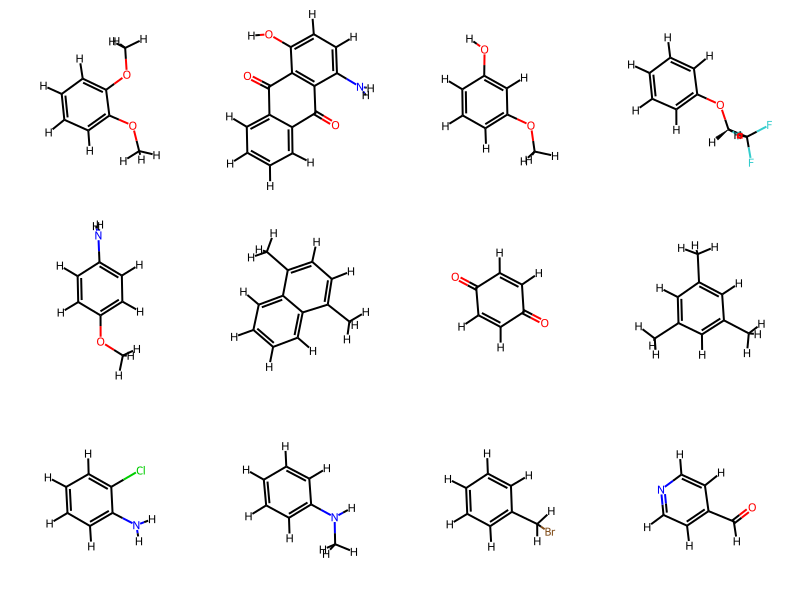

In [2]:
# Getting Data
from rdkit import Chem
from konnektor.data import get_benzene_ligands

rw_components = get_benzene_ligands()
rw_components = list(
    filter(lambda x: not x.name in ["lig_2", "lig_3", "lig_4", "lig_7"], rw_components)
)
Chem.Draw.MolsToGridImage([c.to_rdkit() for c in rw_components], molsPerRow=4)

In [7]:
# Load AtomMapper and Scorer
from kartograf import KartografAtomMapper, MappingRMSDScorer

mapper = KartografAtomMapper()
scorer = MappingRMSDScorer()

## Construct __Cyclic Network Layout__
We build a `CyclicNetworkGenerator` by passing the `AtomMapper` and `AtomMappingScorer` from Kartograf and use the generator with the components.

In [4]:
from konnektor.network_planners import CyclicNetworkGenerator

network_planner = CyclicNetworkGenerator(
    mappers=mapper, scorer=scorer, n_processes=1
)

cyclic_network_rw = network_planner(rw_components)
cyclic_network_rw.name = "Real World Cyclic Network"
cyclic_network_rw

<LigandNetwork-4c30497a38e08c624651ce0a765a917d>

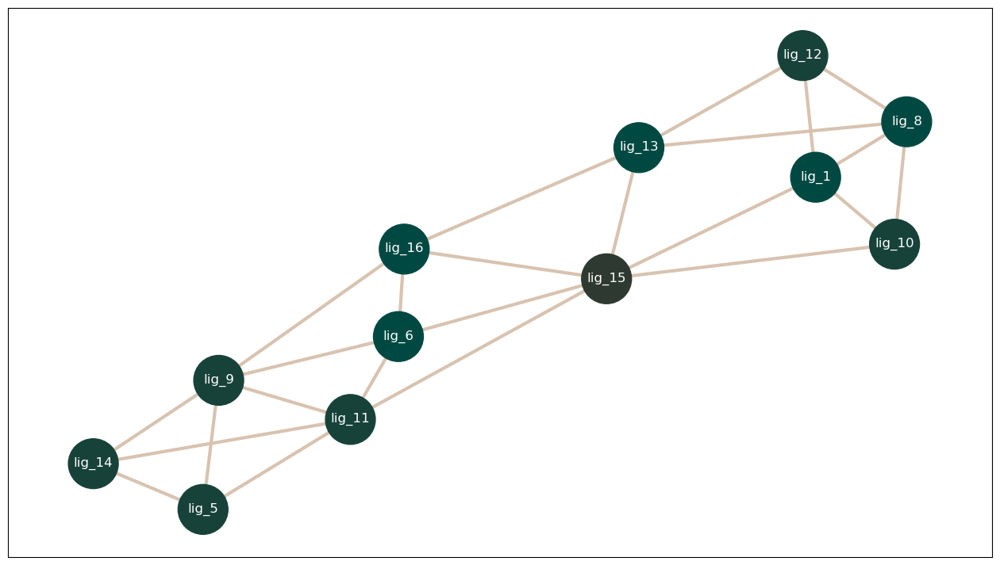

In [5]:
# NBVAL_SKIP
from konnektor.visualization import draw_ligand_network
draw_ligand_network(cyclic_network_rw);

In [6]:
# note that this will only work in an interactive session

# from konnektor.visualization import draw_network_widget

# draw_network_widget(cyclic_network_rw, show_molecules=True, show_mappings=True);